In [111]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

<function matplotlib.pyplot.show(close=None, block=None)>

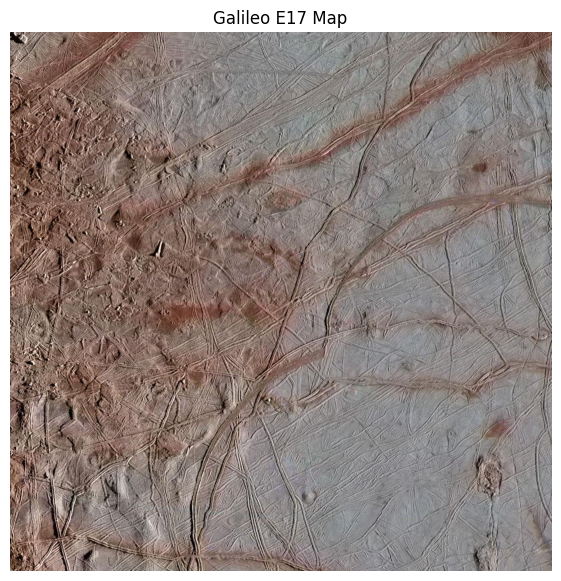

In [112]:
# Load image

# img_path = "/mnt/data/borvo_mensa.jpg"
img_path = r"europa_map\raw\GalileoE17.jpg"
img = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
height, width, _ = img.shape

# Original Map
plt.figure(figsize=(12, 7))
plt.imshow(img_rgb)
plt.title("Galileo E17 Map")
plt.axis('off')
plt.show

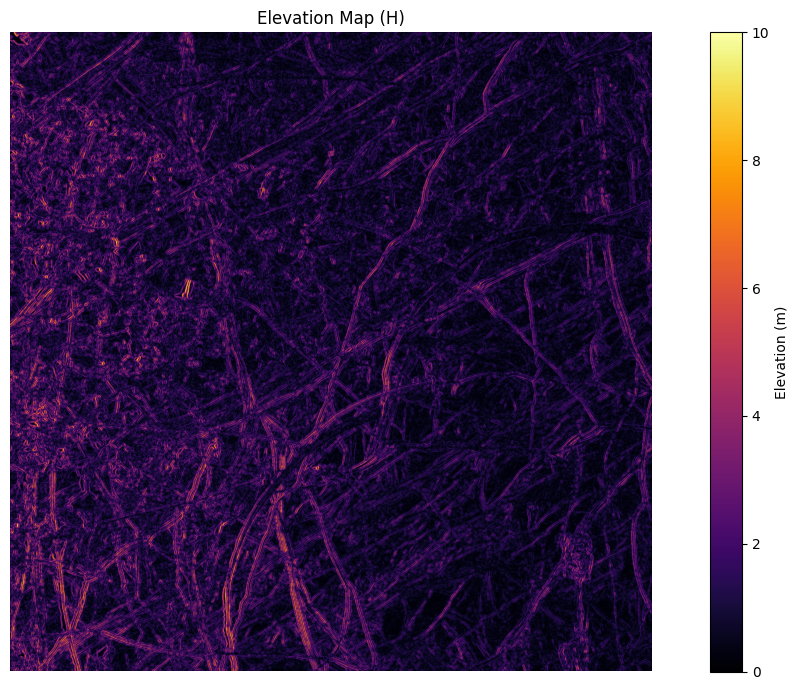

In [113]:
# Height (Elevation) Extraction

# Extract elevation (H) based on brightness
gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

# Gradient-based pseudo-height map
sobelx = cv2.Sobel(gray, cv2.CV_32F, 1, 0, ksize=5)
sobely = cv2.Sobel(gray, cv2.CV_32F, 0, 1, ksize=5)
magnitude = np.sqrt(sobelx**2 + sobely**2)
H_map = cv2.normalize(magnitude, None, 0, 10, cv2.NORM_MINMAX)

plt.figure(figsize=(12, 7))
plt.imshow(H_map, cmap="inferno")
plt.colorbar(label="Elevation (m)")
plt.title("Elevation Map (H)")
plt.axis("off")
plt.tight_layout()
plt.show()

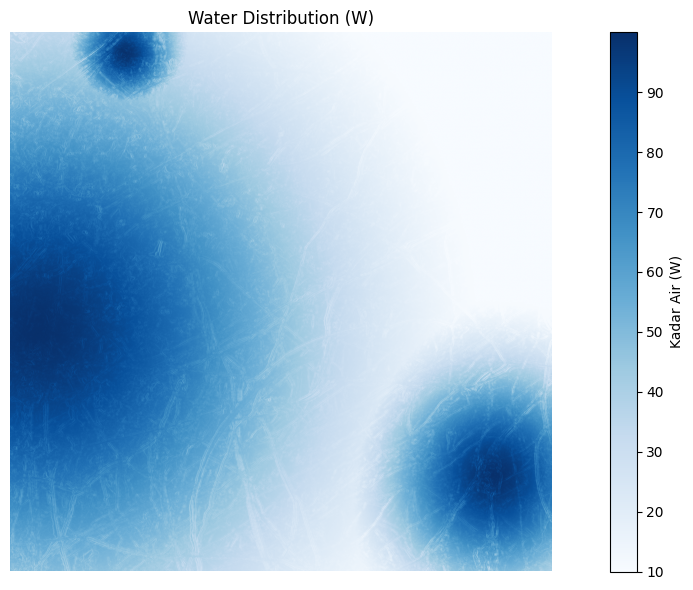

In [114]:
# Water sources
def pin_water(x, y, spread, H_factor):
    return (x, y, spread, H_factor)
def pin_water_pct(x_pct, y_pct, spread, H_factor):
    return (x_pct * width / 100, y_pct * height / 100, spread, H_factor)

waters = [
    pin_water(277, 54, 100, 10), pin_water(60, 722, 500, 16),
    pin_water(1166, 1074, 200, 15)
]

# Spread water on the map
def pour_water(center, Hmap, max_val=100, sigma=100, H_factor=30):
    y_idx, x_idx = np.indices(Hmap.shape)
    distance = np.sqrt((x_idx - center[0])**2 + (y_idx - center[1])**2)
    real_distance = distance + H_factor * Hmap

    decay = max_val * np.exp(-(real_distance**2) / (2 * sigma**2))        # Gaussian decay
    return decay

# Rebuild water map dengan baseline 10
W_map = np.full((height, width), 10.0)
for cx, cy, sprd, h in waters:
    radial = pour_water((cx, cy), H_map, max_val=100, sigma=sprd, H_factor=h)
    W_map = np.maximum(W_map, radial)

# Visualize water distribution map
plt.figure(figsize=(12, 6))
plt.imshow(W_map, cmap="Blues")
plt.colorbar(label="Kadar Air (W)")
plt.title("Water Distribution (W)")
plt.axis('off')
plt.tight_layout()
plt.show()


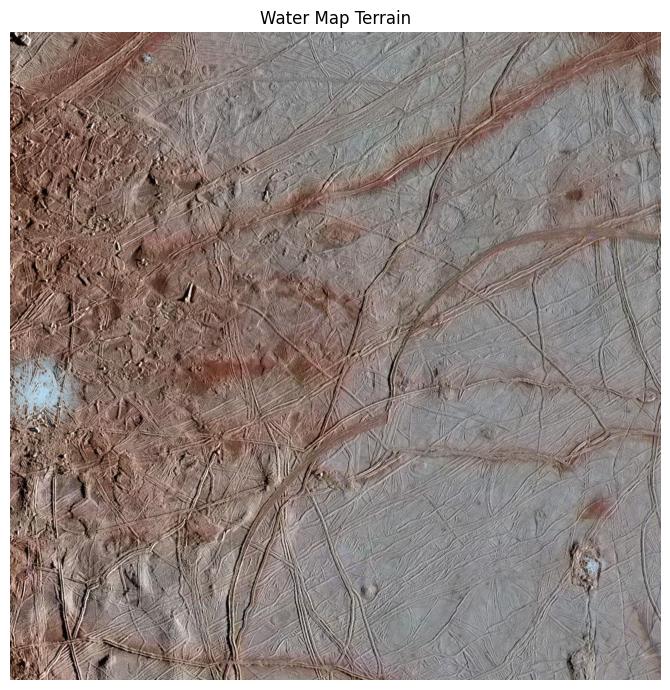

In [115]:
# Water Map Terrain

# Only W > 98 have alpha > 0 (displayed)
W_alpha = np.clip((W_map - 98) / 2, 0, 1)

# Blending to map
water_color = np.array([182, 219, 242]) / 255
blended = img_rgb / 255.0
for c in range(3):
    blended[:, :, c] = (1 - W_alpha) * blended[:, :, c] + W_alpha * water_color[c]

# Visualize watered map
plt.figure(figsize=(12, 7))
plt.imshow(blended)
plt.title("Water Map Terrain")
plt.axis('off')
plt.tight_layout()
plt.show()
# plt.savefig("first_waterMap.png", bbox_inches='tight', pad_inches=0, dpi=300)
# print("W_map max:", np.max(W_map))



In [116]:
# Gabungkan jadi DataFrame
rows = []
for i in range(height):
    for j in range(width):
        h = H_map[i, j]
        w = W_map[i, j]  # pastikan W_map sudah dihitung sebelum ini
        rows.append([i, j, h, w])

df_HW = pd.DataFrame(rows, columns=["i", "j", "H", "W"])
df_HW.to_csv(r"dataset\E17_HW_map.csv", index=False)


In [117]:
HFrame = pd.DataFrame(H_map)
HFrame

,0,1,2,3,4,5,6,7,8,9,...,1296,1297,1298,1299,1300,1301,1302,1303,1304,1305
0,0.000000,2.048930,1.770701,0.042936,0.960060,0.664657,0.513520,1.674523,4.046336,6.596764,...,0.065263,1.995688,1.640174,0.657787,0.305708,1.521670,0.819228,2.258460,0.894797,0.000000
1,1.738069,2.210285,1.744700,0.703623,1.257343,1.528293,1.629634,2.301621,4.679042,7.114212,...,0.316164,1.941516,1.588740,0.653387,0.209727,1.437107,0.691627,2.095799,0.957283,0.575349
2,1.626434,1.615503,1.207352,0.523086,0.761323,1.132173,1.432133,2.671816,5.784987,8.138639,...,0.829718,1.737018,1.422072,0.600327,0.158253,1.223847,0.434232,1.676185,0.857414,0.674962
3,1.061390,0.975938,0.754378,0.413485,0.257633,0.333811,0.589948,2.045783,5.945579,9.080998,...,0.959739,1.228612,1.127177,0.463205,0.302548,1.082993,0.143857,1.424859,0.700468,0.036067
4,0.724768,0.693476,0.580067,0.322629,0.059308,0.123257,0.179579,1.042942,4.711658,8.883008,...,0.723922,0.888401,0.903701,0.389801,0.340257,0.997696,0.272746,1.688329,1.484102,1.279508
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296,0.058394,0.982154,1.722040,2.322438,2.498694,2.163584,1.285496,1.902479,2.034482,0.518596,...,0.226737,0.238875,0.432599,0.567604,0.245218,0.491387,0.531825,0.500410,0.382562,0.183768
1297,0.216400,0.610427,1.387645,1.847982,1.827407,2.553640,3.256302,2.805928,1.547536,2.755325,...,0.415826,0.381172,0.141297,0.400859,0.418372,0.756706,0.669868,0.640246,0.552532,0.254184
1298,0.484324,0.616417,1.456604,1.530099,1.275547,2.337344,3.862285,4.382814,2.751662,3.057340,...,0.201353,0.306876,0.250278,0.359557,0.389506,0.685077,0.383992,0.535210,0.538797,0.187203
1299,0.283381,0.502594,1.484476,1.231007,0.700257,1.130005,2.306237,3.787374,2.393433,1.855316,...,0.077809,0.544844,0.422872,0.335211,0.220026,0.471738,0.119342,0.480413,0.423531,0.152854


In [118]:
WFrame = pd.DataFrame(W_map)
WFrame

,0,1,2,3,4,5,6,7,8,9,...,1296,1297,1298,1299,1300,1301,1302,1303,1304,1305
0,35.001894,31.769230,32.207029,34.956802,33.493875,33.971589,34.221022,32.393700,28.828195,25.267944,...,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
1,32.338640,31.616924,32.344183,33.993435,33.122512,32.704605,32.553602,31.521358,28.005481,24.662266,...,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
2,32.609704,32.634828,33.284135,34.382678,34.008609,33.426245,32.960505,31.051491,26.537559,23.412884,...,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
3,33.597804,33.741847,34.103587,34.659644,34.919697,34.804115,34.398552,32.107614,26.401866,22.307060,...,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
4,34.234456,34.292954,34.483462,34.907399,35.343510,35.247123,35.163139,33.780767,28.226767,22.630509,...,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296,51.257380,49.525703,48.153263,47.050520,46.736325,47.367011,49.014080,47.873411,47.638733,50.488838,...,42.770622,42.578809,41.633064,40.936308,42.125617,40.966333,40.658291,40.643958,40.983046,41.656716
1297,50.840305,50.108254,48.661192,47.814772,47.864382,46.531455,45.254404,46.089042,48.429266,46.202651,...,41.744621,41.748687,42.604961,41.386808,41.173652,39.652855,39.864345,39.843330,40.057333,41.133223
1298,50.216687,49.979811,48.416278,48.290769,48.777527,46.815543,44.042054,43.116880,46.084826,45.535109,...,42.395848,41.818161,41.912826,41.320910,41.057254,39.711790,40.797493,40.038941,39.882806,41.175874
1299,50.478624,50.077123,48.248316,48.733098,49.739954,48.944668,46.768979,44.075367,46.629263,47.634989,...,42.670530,40.601905,40.963771,41.184994,41.519529,40.346377,41.652093,40.030366,40.120273,41.084044


In [119]:
WFrame.describe()

,0,1,2,3,4,5,6,7,8,9,...,1296,1297,1298,1299,1300,1301,1302,1303,1304,1305
count,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,...,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000,1301.000000
mean,75.057002,74.158787,73.932538,73.882677,73.990249,73.898768,74.091423,74.144123,74.102002,74.220936,...,29.677608,29.659904,29.661903,29.547599,29.523520,29.408089,29.445074,29.352320,29.331296,29.745761
std,19.098760,19.334190,19.521949,19.585163,19.666298,19.802446,19.784572,19.727889,19.863595,19.843927,...,25.527397,25.540951,25.470559,25.378940,25.288309,25.143302,25.216898,25.093502,25.046362,25.310925
min,30.178958,29.791171,29.504805,30.645640,32.019987,30.605950,29.206263,29.181354,26.401866,22.307060,...,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
25%,59.690981,58.158917,56.997796,56.517875,56.991312,56.341022,57.200214,56.376379,56.601944,56.677247,...,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
50%,78.370949,77.260305,76.855035,77.687825,77.697127,77.058027,76.885050,77.408679,77.591723,77.608532,...,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
75%,92.880428,92.178873,92.199237,92.162385,92.310007,92.585276,92.603233,92.669441,92.885721,92.608819,...,53.226345,53.788494,54.091791,54.038997,54.027190,52.855927,53.254207,53.719325,54.421544,54.419981
max,99.231521,99.072112,99.151971,99.258387,99.261307,99.254037,99.210401,99.375672,99.354681,99.383504,...,80.804877,80.192377,79.726358,79.784566,79.557144,79.505566,79.113686,78.519795,78.369797,78.368827


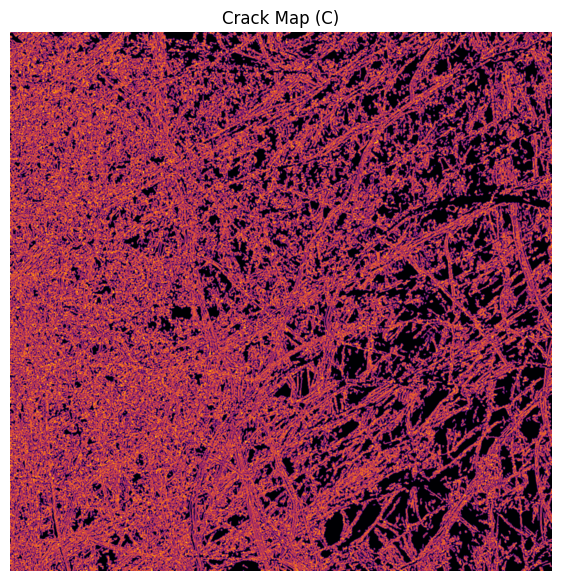

In [120]:
# Extract Ice Cracks

# Grayscale image
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Crack map (C_map) -> Celah es
edges = cv2.Canny(gray, 100, 200)
C_blurred = cv2.GaussianBlur(edges.astype(np.float32), (5, 5), 0)
C_map = np.clip(C_blurred / C_blurred.max(), 0, 1)

# Crack Detection (Canny for cracks/celestial fissures)
edges = cv2.Canny(gray, threshold1=100, threshold2=200)

# Convert to crack severity (C_map)
blurred = cv2.GaussianBlur(edges.astype(np.float32), (5, 5), 0)
C_map = blurred / blurred.max()  # normalize to 0–1
C_map = np.clip(C_map, 0, 1)

# Plot
plt.figure(figsize=(12, 7))
plt.imshow(C_map, cmap='inferno')
plt.title("Crack Map (C)")
plt.axis('off')
plt.show()


<function matplotlib.pyplot.show(close=None, block=None)>

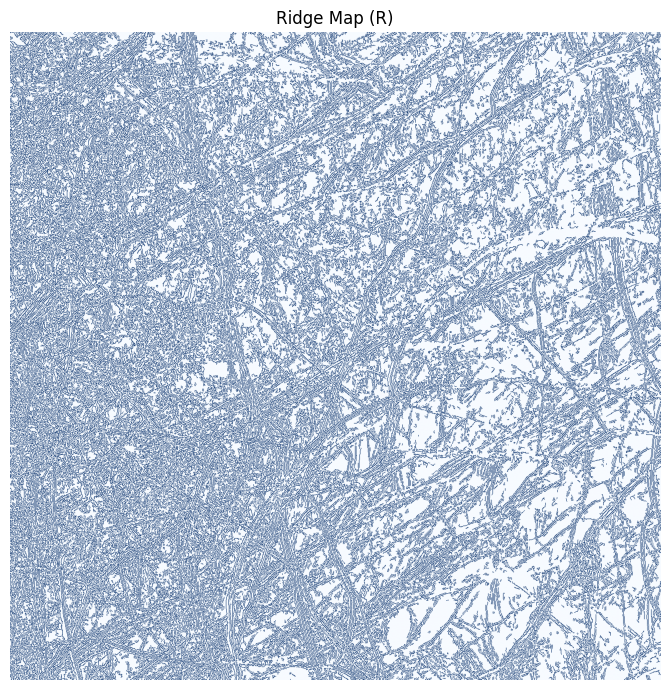

In [121]:
# Extract Ridges

# Resistance map (R_map) -> Ridges
sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
R_gradient = np.sqrt(sobelx**2 + sobely**2)
R_map = R_gradient / R_gradient.max()

resist_map = (R_map > 0.4).astype(np.uint8)
laplacian = cv2.Laplacian(gray, cv2.CV_64F)
resist_map = (np.abs(laplacian) > 45).astype(np.uint8)

edges = cv2.Canny(gray, 100, 200)
resist_map = (edges > 0).astype(np.uint8)
plt.figure(figsize=(10, 7))
plt.imshow(resist_map, cmap='Blues')
plt.title("Ridge Map (R)")
plt.axis('off')
plt.tight_layout()
plt.show

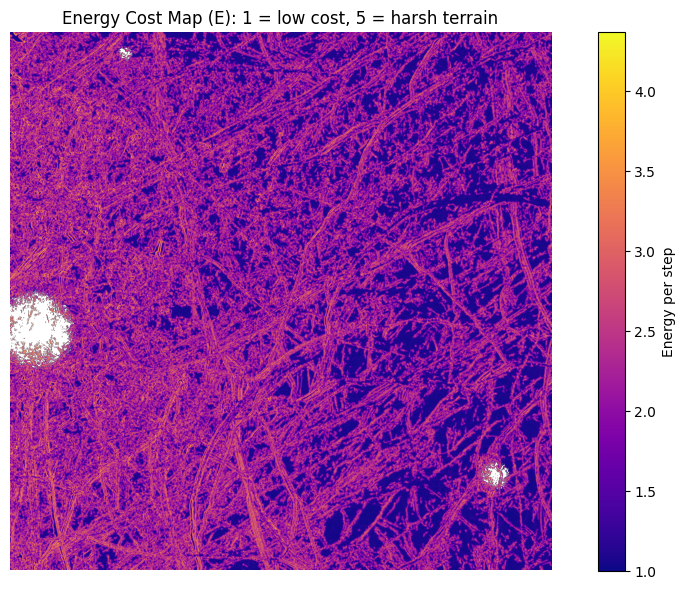

In [122]:
# Energy Consumption Map

# Compute E_map
E_map = 1 + 2 * R_map + 2 * C_map

E_map[W_map > 98] = np.nan  # block water areas
E_map = np.clip(E_map, 1, 5)

# Visualize E_map
plt.figure(figsize=(12, 7))
plt.imshow(E_map, cmap='plasma')
plt.title("Energy Cost Map (E): 1 = low cost, 5 = harsh terrain")
plt.colorbar(label='Energy per step')
plt.axis('off')
plt.show()


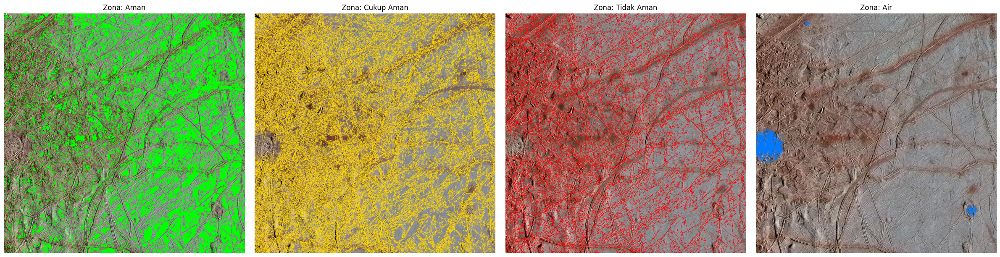

In [123]:
# Zone Map (Z)

Z_map = np.full((height, width), -1, dtype=int)

# Zona Air (kode: 3)
Z_map[W_map > 98] = 3

# Aman (kode: 0)
mask_aman = np.logical_and.reduce((
    W_map <= 98,
    R_map <= 0.35,
    C_map <= 0.3
))
Z_map[mask_aman] = 0

# Tidak Aman (kode: 2)
mask_bahaya = np.logical_and.reduce((
    W_map <= 98,
    np.logical_or(R_map > 0.6, C_map > 0.55)
))
Z_map[mask_bahaya] = 2

# Cukup Aman (kode: 1)
mask_cukup = np.logical_and.reduce((
    W_map <= 98,
    Z_map == -1  # semua yang belum terisi dan bukan zona air/bahaya
))
Z_map[mask_cukup] = 1

# Visualize Z_map
Z_labels = ['Aman', 'Cukup Aman', 'Tidak Aman', 'Air']
Z_colors = [
    [0, 255, 0],
    [255, 215, 0],
    [255, 0, 0],
    [0, 120, 255]
]

fig, axes = plt.subplots(1, 4, figsize=(24, 6))
for z in range(4):
    Z_overlay = img_rgb.copy()
    mask = (Z_map == z)
    for c in range(3):
        Z_overlay[:, :, c] = np.where(mask, Z_colors[z][c], img_rgb[:, :, c])
    axes[z].imshow(Z_overlay)
    axes[z].set_title(f"Zona: {Z_labels[z]}")
    axes[z].axis('off')

plt.tight_layout()
plt.show()


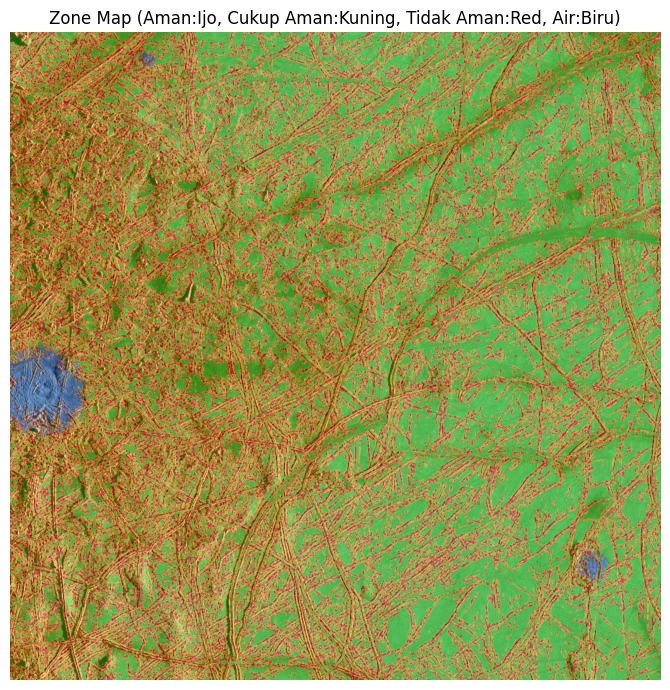

In [124]:
overlay_clr = {
    0: (0, 255, 0),      # Aman → Hijau
    1: (255, 215, 0),    # Cukup Aman → Kuning emas
    2: (255, 0, 0),      # Tidak Aman → Merah
    3: (0, 120, 255)     # Air → Biru terang
}

Z_mix = img_rgb.copy()
alpha = 0.4  # transparansi

# Terapkan overlay untuk setiap zona
for z, color in overlay_clr.items():
    mask = (Z_map == z)
    Z_layer = np.ones_like(img_rgb, dtype=np.uint8) * np.array(color, dtype=np.uint8)
    Z_mix[mask] = (
        alpha * Z_layer[mask] + (1 - alpha) * img_rgb[mask]
    ).astype(np.uint8)

# Tampilkan hasil gabungan
plt.figure(figsize=(12, 7))
plt.imshow(Z_mix)
plt.title("Zone Map (Aman:Ijo, Cukup Aman:Kuning, Tidak Aman:Red, Air:Biru)")
plt.axis('off')
plt.tight_layout()
plt.show()


In [125]:
ZFrame = pd.DataFrame(Z_map)
CFrame = pd.DataFrame(C_map)
RFrame = pd.DataFrame(R_map)
EFrame = pd.DataFrame(E_map)

ZFrame

,0,1,2,3,4,5,6,7,8,9,...,1296,1297,1298,1299,1300,1301,1302,1303,1304,1305
0,2,2,1,1,1,1,1,1,1,2,...,0,1,1,1,1,2,2,2,1,0
1,2,2,1,0,0,1,1,1,1,2,...,0,1,1,1,1,2,2,2,1,0
2,1,0,0,0,0,0,0,0,1,2,...,0,1,1,1,1,2,2,2,1,0
3,0,0,0,0,0,0,0,0,1,2,...,0,1,1,1,1,2,2,2,1,1
4,0,0,0,0,0,0,0,0,1,2,...,0,1,2,1,1,2,2,2,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296,0,0,1,2,1,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
1297,0,0,1,1,1,1,2,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1298,0,0,1,1,1,1,2,2,1,1,...,0,0,0,0,0,0,0,0,0,0
1299,0,1,1,1,0,1,2,2,1,1,...,0,0,0,0,0,0,0,0,0,0


In [126]:
CFrame

,0,1,2,3,4,5,6,7,8,9,...,1296,1297,1298,1299,1300,1301,1302,1303,1304,1305
0,0.86,0.770,0.530,0.340,0.360,0.460,0.490,0.440,0.420,0.460,...,0.080,0.320,0.480,0.400,0.40,0.560,0.640,0.560,0.320,0.16
1,0.69,0.605,0.395,0.235,0.240,0.315,0.360,0.370,0.420,0.475,...,0.080,0.320,0.480,0.400,0.40,0.560,0.640,0.560,0.320,0.16
2,0.33,0.275,0.155,0.070,0.060,0.090,0.135,0.220,0.395,0.510,...,0.080,0.320,0.480,0.400,0.40,0.560,0.640,0.565,0.340,0.19
3,0.07,0.055,0.025,0.005,0.000,0.005,0.020,0.105,0.345,0.555,...,0.100,0.355,0.520,0.435,0.42,0.565,0.645,0.600,0.435,0.32
4,0.00,0.000,0.000,0.000,0.000,0.000,0.000,0.055,0.275,0.555,...,0.155,0.440,0.615,0.535,0.49,0.585,0.655,0.655,0.565,0.49
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296,0.21,0.265,0.430,0.565,0.535,0.495,0.530,0.490,0.355,0.265,...,0.000,0.000,0.000,0.000,0.00,0.000,0.000,0.000,0.000,0.00
1297,0.09,0.190,0.395,0.485,0.450,0.505,0.600,0.530,0.380,0.380,...,0.000,0.000,0.000,0.000,0.00,0.000,0.000,0.000,0.000,0.00
1298,0.11,0.250,0.450,0.420,0.310,0.425,0.660,0.690,0.530,0.495,...,0.000,0.000,0.000,0.000,0.00,0.000,0.000,0.000,0.000,0.00
1299,0.15,0.325,0.550,0.455,0.240,0.310,0.610,0.715,0.545,0.480,...,0.000,0.000,0.000,0.000,0.00,0.000,0.000,0.000,0.000,0.00


In [127]:
RFrame

,0,1,2,3,4,5,6,7,8,9,...,1296,1297,1298,1299,1300,1301,1302,1303,1304,1305
0,0.000000,0.204893,0.177070,0.004294,0.096006,0.066466,0.051352,0.167452,0.404634,0.659676,...,0.006526,0.199569,0.164017,0.065779,0.030571,0.152167,0.081923,0.225846,0.089480,0.000000
1,0.173807,0.221029,0.174470,0.070362,0.125734,0.152829,0.162963,0.230162,0.467904,0.711421,...,0.031616,0.194152,0.158874,0.065339,0.020973,0.143711,0.069163,0.209580,0.095728,0.057535
2,0.162643,0.161550,0.120735,0.052309,0.076132,0.113217,0.143213,0.267182,0.578499,0.813864,...,0.082972,0.173702,0.142207,0.060033,0.015825,0.122385,0.043423,0.167619,0.085741,0.067496
3,0.106139,0.097594,0.075438,0.041349,0.025763,0.033381,0.058995,0.204578,0.594558,0.908100,...,0.095974,0.122861,0.112718,0.046321,0.030255,0.108299,0.014386,0.142486,0.070047,0.003607
4,0.072477,0.069348,0.058007,0.032263,0.005931,0.012326,0.017958,0.104294,0.471166,0.888301,...,0.072392,0.088840,0.090370,0.038980,0.034026,0.099770,0.027275,0.168833,0.148410,0.127951
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296,0.005839,0.098215,0.172204,0.232244,0.249869,0.216358,0.128550,0.190248,0.203448,0.051860,...,0.022674,0.023888,0.043260,0.056760,0.024522,0.049139,0.053183,0.050041,0.038256,0.018377
1297,0.021640,0.061043,0.138764,0.184798,0.182741,0.255364,0.325630,0.280593,0.154754,0.275533,...,0.041583,0.038117,0.014130,0.040086,0.041837,0.075671,0.066987,0.064025,0.055253,0.025418
1298,0.048432,0.061642,0.145660,0.153010,0.127555,0.233734,0.386229,0.438281,0.275166,0.305734,...,0.020135,0.030688,0.025028,0.035956,0.038951,0.068508,0.038399,0.053521,0.053880,0.018720
1299,0.028338,0.050259,0.148448,0.123101,0.070026,0.113001,0.230624,0.378737,0.239343,0.185532,...,0.007781,0.054484,0.042287,0.033521,0.022003,0.047174,0.011934,0.048041,0.042353,0.015285


In [128]:
EFrame

,0,1,2,3,4,5,6,7,8,9,...,1296,1297,1298,1299,1300,1301,1302,1303,1304,1305
0,2.720000,2.949786,2.414140,1.688587,1.912012,2.052931,2.082704,2.214905,2.649267,3.239353,...,1.173053,2.039138,2.288035,1.931557,1.861142,2.424334,2.443846,2.571692,1.818959,1.320000
1,2.727614,2.652057,2.138940,1.610725,1.731469,1.935659,2.045927,2.200324,2.775808,3.372842,...,1.223233,2.028303,2.277748,1.930677,1.841945,2.407421,2.418325,2.539160,1.831457,1.435070
2,1.985287,1.873101,1.551470,1.244617,1.272265,1.406435,1.556427,1.974363,2.946997,3.647728,...,1.325944,1.987404,2.244414,1.920065,1.831651,2.364769,2.366846,2.465237,1.851483,1.514992
3,1.352278,1.305188,1.200876,1.092697,1.051527,1.076762,1.157990,1.619157,2.879116,3.926200,...,1.391948,1.955722,2.265435,1.962641,1.900510,2.346599,2.318771,2.484972,2.010094,1.647213
4,1.144954,1.138695,1.116013,1.064526,1.011862,1.024651,1.035916,1.318588,2.492332,3.886602,...,1.454784,2.057680,2.410740,2.147960,2.048051,2.369539,2.364549,2.647666,2.426820,2.235902
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296,1.431679,1.726431,2.204408,2.594488,2.569739,2.422717,2.317099,2.360496,2.116897,1.633719,...,1.045347,1.047775,1.086520,1.113521,1.049044,1.098277,1.106365,1.100082,1.076512,1.036754
1297,1.223280,1.502085,2.067529,2.339596,2.265481,2.520728,2.851261,2.621186,2.069507,2.311065,...,1.083165,1.076234,1.028259,1.080172,1.083674,1.151341,1.133974,1.128049,1.110507,1.050837
1298,1.316865,1.623283,2.191321,2.146020,1.875109,2.317469,3.092457,3.256563,2.610332,2.601468,...,1.040271,1.061375,1.050056,1.071911,1.077901,1.137015,1.076798,1.107042,1.107759,1.037441
1299,1.356676,1.750519,2.396895,2.156201,1.620051,1.846001,2.681247,3.187475,2.568687,2.331063,...,1.015562,1.108969,1.084574,1.067042,1.044005,1.094348,1.023868,1.096083,1.084706,1.030571
